# **Face Detection with YOLO11 Utilizing the WIDER FACE Dataset**

In this notebook, the [YOLO11](https://docs.ultralytics.com/models/yolo11/) model from [Ultralytics](https://www.ultralytics.com/) is fine-tuned, which is the latest and most advanced deep learning model in the YOLO series for real-time object detection. The YOLO11 models are pretrained on the [COCO](https://docs.ultralytics.com/datasets/detect/coco/#coco-pretrained-models) dataset, which consists of 200,000 images and 80 object categories, providing a strong foundation for general object detection tasks. Fine-tuning of the model is carried out using the [WIDER FACE](https://shuoyang1213.me/WIDERFACE/) dataset, which serves as a benchmark for face detection. It features images selected from the [WIDER](https://www.cv-foundation.org/openaccess/content_cvpr_2015/html/Xiong_Recognize_Complex_Events_2015_CVPR_paper.html) dataset.

WIDER FACE contains a total of 32,203 images and 393,703 annotated faces. It is organized into 61 event classes and includes faces with extreme challenges due to substantial variations, such as `blur`, `expression`, `illumination`, `occlusion`, `pose`, and `invalid` (low-resolution and very small-scale annotations). This makes it a robust dataset ideal for evaluating face detection algorithms under complex conditions.

The dataset is divided into 12,880 training images, 3,226 validation images, and 16,097 test images (the latter do not include annotations and will not be considered for model evaluation). According to its [official paper](https://arxiv.org/pdf/1511.06523), it is categorized into three levels of difficulty: `Easy`, `Medium`, and `Hard`, based on the EdgeBox detection rate, which evaluates performance relative to the detection complexity across the 61 event classes. However, for this fine-tuning, all event classes will be included to increase the model's complexity and robustness.






## **Imports**

In [ ]:
# Installation of the Ultralytics library
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.4/887.4 kB 27.6 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from PIL import Image
from google.colab import drive
from glob import glob
from IPython.display import clear_output, display, Video
import shutil
import os

# Necessary in Colab with Ultralytics to prevent path-related encoding errors
import locale
locale.getpreferredencoding = lambda: "UTF-8"

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Mount Google Drive in Colab
drive.mount("/content/drive")

Mounted at /content/drive


## **Parameters**

In [ ]:
batch_size = 4 #The batch size is very small due to the 15 GB of free GPU provided by Colab
epochs = 25
patience = 5
zip_dataset = "/content/drive/MyDrive/Datasets/WIDER-FACE.zip"
path_dataset = "/content/datasets/WIDER-FACE"
path_save_results = "/content/drive/MyDrive/Ultralytics"

## **Preparing the Dataset for Training**

### **Load the Dataset**

The download, along with all the preprocessing and analysis of the WIDER FACE dataset, has been completed in the following notebook: [Preprocessing_WIDER-FACE](https://github.com/JersonGB22/ObjectDetection-TensorFlow-PyTorch/blob/main/Preprocessing/Preprocessing_WIDER-FACE.ipynb). Therefore, in this case, it will only be necessary to unzip the zip file.

In [ ]:
!unzip -q $zip_dataset -d /content/datasets

### **Visualization Example**

Next, an example of the training dataset is manually plotted. With Ultralytics, data augmentation, training, and inference are very straightforward processes, so it won't even be necessary to plot the images with their respective bounding boxes, as will be demonstrated later.

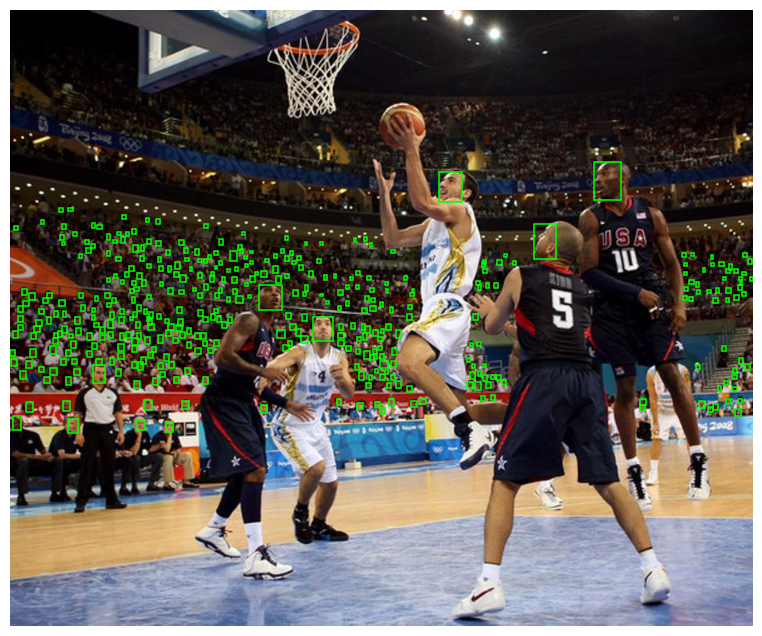

In [ ]:
fig, ax = plt.subplots(1, figsize=(10, 8))

image = Image.open("/content/datasets/WIDER-FACE/train/images/35_Basketball_basketballgame_ball_35_1041.jpg")
image = np.array(image)
shape = image.shape
ax.imshow(image)

annotation = np.loadtxt("/content/datasets/WIDER-FACE/train/labels/35_Basketball_basketballgame_ball_35_1041.txt")
annotation = annotation[None, :] if annotation.ndim == 1 else annotation
classes = annotation[:, 0]
boxes = annotation[:, 1:]

for i in range(len(boxes)):
  box = boxes[i]
  cls = classes[i].astype(np.int32)

  x_center, y_center, width, height = tuple(box)
  xmin = (x_center - width / 2) * shape[1]
  ymin = (y_center - height / 2) * shape[0]
  xmax = (x_center + width / 2) * shape[1]
  ymax = (y_center + height / 2) * shape[0]

  rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1.1, edgecolor=(0.0, 1.0, 0.0), facecolor="none")
  ax.add_patch(rect)

ax.axis("off");

## **Initializing and Training the Model**

The YOLO model downloaded from the Ultralytics GitHub is a **PyTorch** model, meaning it cannot currently be trained on Colab's TPU to accelerate the process. In this case, the specific version used is **YOLO11m**, which has over 20 million parameters. With Ultralytics, it is not necessary to specify the optimizer or learning rate, as these are automatically selected based on the dataset size and the number of epochs. However, in this particular case, this configuration is not ideal for the WIDER FACE dataset. Instead, these parameters are manually chosen through experimentation to ensure the model converges within just 25 epochs. Freezing the backbone layers, in this case, reduces the model's performance, so it is not applied. Additionally, since there is a large number of very small instances, an image size (`imgsz`) of 1024 is selected to achieve the best results.

Regarding data augmentation to make the model more robust and prevent overfitting, with Ultralytics, it is simply a matter of adjusting the values of each transformation since everything is implemented with the [Albumentations](https://albumentations.ai/), [OpenCV](https://opencv.org/) and [Torchvision](https://pytorch.org/vision/stable/index.html) libraries.

During training, the YOLO model uses the following three losses:

- **box_loss**: This is the **Complete Intersection over Union (CIoU) Loss**. This loss function considers not only the overlap between the predicted and actual bounding boxes but also the distance between their centers and the aspect ratio. This makes it a more thorough metric for assessing box alignment. It surpasses the performance of IoU (Intersection over Union), GIoU (Generalized IoU), and DIoU (Distance IoU) losses.

- **cls_loss**: This is the **Binary Cross Entropy loss with logits** applied to the model's classifier.

- **dfl_loss**: This refers to the **Distribution Focal Loss (DFL)**, an enhanced variant of the focal loss aimed at giving greater emphasis to difficult-to-classify instances. It modifies the focal loss according to the class distribution, enhancing the model's sensitivity to minority classes and helping to address class imbalance.

Lastly, since the training time for YOLO models can be lengthy, Ultralytics provides options to resume training from where it was left off. This is useful in case of interruptions or if the free GPU time limit of 3 hours and 40 minutes on Google Colab is exceeded. In this case, the total training time is approximately **9.5 hours**, configured for 25 epochs.




In [ ]:
## @title Choose Whether to Resume Training
pretrained = True # @param {type:"boolean"}

In [ ]:
name_project = os.path.join(path_save_results, "FaceDetection_YOLO11m_WIDER-FACE")

In [ ]:
if pretrained:
  model = YOLO(os.path.join(name_project, "weights/last.pt"))
else:
  model = YOLO("yolo11m.pt")

model.info()

YOLO11m summary: 409 layers, 20,053,779 parameters, 0 gradients, 68.2 GFLOPs


(409, 20053779, 0, 68.1886208)

In [ ]:
if pretrained:
  results = model.train(resume=True)

else:
  results = model.train(
      data=os.path.join(path_dataset, "data.yaml"),
      epochs=epochs,
      patience=patience,
      batch=batch_size,
      imgsz=1024,
      single_cls=True, #Specifies that the dataset contains only one class
      optimizer="AdamW",
      lr0=3.2e-4,
      lrf=0.01,
      momentum=0.9,
      deterministic=True, #Allows for reproducibility of the training
      verbose=False,
      project=path_save_results,
      name=name_project,

  # Data Augmentation
      hsv_h=0.015, #Randomly adjusts the hue of the image within the range [1-0.015; 1+0.015]
      hsv_s=0.3, #Randomly adjusts the saturation of the image within the range [1-0.3; 1+0.3]
      hsv_v=0.4, #Randomly adjusts the brightness of the image within the range [1-0.4; 1+0.4]
      translate=0.1, #Randomly shifts the image horizontally and vertically by up to 10% of its original size
      scale=0.25, #Randomly scales the image size within the range of [100%-25%; 100%+25%]
      fliplr=0.5, #Horizontal flip of the image with a probability of 0.5
      mosaic=1.0, #Combines 4 images into one with a probability of 1
      close_mosaic=0, #Allows applying the mosaic in all epochs
      erasing=0.25 #25% probability of applying random erasure using 'torchvision.transforms.RandomErasing'
  )

Ultralytics 8.3.34 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/last.pt, data=/content/datasets/WIDER-FACE/data.yaml, epochs=25, time=None, patience=5, batch=4, imgsz=1024, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/Ultralytics, name=FaceDetection_YOLO11m_WIDER-FACE, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=False, seed=0, deterministic=True, single_cls=True, rect=False, cos_lr=False, close_mosaic=0, resume=/content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visua

100%|██████████| 755k/755k [00:00<00:00, 36.9MB/s]


TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    111872  ultralytics.nn.modules.block.C3k2            [128, 256, 1, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  1    444928  ultralytics.nn.modules.block.C3k2            [256, 512, 1, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  1   1380352  ultralytics.nn.m

100%|██████████| 5.35M/5.35M [00:00<00:00, 127MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/WIDER-FACE/train/labels... 12880 images, 0 backgrounds, 0 corrupt: 100%|██████████| 12880/12880 [00:27<00:00, 461.33it/s]


train: New cache created: /content/datasets/WIDER-FACE/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/datasets/WIDER-FACE/val/labels... 3226 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3226/3226 [00:03<00:00, 812.12it/s] 


val: New cache created: /content/datasets/WIDER-FACE/val/labels.cache
Plotting labels to /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/labels.jpg... 
optimizer: AdamW(lr=0.00032, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Resuming training /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/last.pt from epoch 19 to 25 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 1024 train, 1024 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25      14.7G      1.257     0.6041      1.047         53       1024: 100%|██████████| 3220/3220 [21:16<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:34<00:00,  4.26it/s]


                   all       3226      39122      0.891      0.712      0.795      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25      10.9G      1.253     0.6005      1.039         50       1024: 100%|██████████| 3220/3220 [21:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:32<00:00,  4.36it/s]


                   all       3226      39122      0.892      0.714      0.798      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25      11.5G      1.231     0.5813      1.032         78       1024: 100%|██████████| 3220/3220 [21:13<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:31<00:00,  4.40it/s]


                   all       3226      39122      0.889      0.716      0.797      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25      14.5G      1.216     0.5676      1.027         34       1024: 100%|██████████| 3220/3220 [21:20<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:32<00:00,  4.35it/s]


                   all       3226      39122      0.889       0.72      0.801      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25      13.4G      1.206     0.5619      1.017          9       1024: 100%|██████████| 3220/3220 [21:17<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:31<00:00,  4.39it/s]


                   all       3226      39122      0.891      0.719      0.801      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25      15.4G      1.192     0.5516      1.015        139       1024: 100%|██████████| 3220/3220 [21:20<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:30<00:00,  4.44it/s]


                   all       3226      39122      0.889       0.72      0.802      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25      12.4G      1.194     0.5484      1.011         34       1024: 100%|██████████| 3220/3220 [21:23<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:34<00:00,  4.28it/s]


                   all       3226      39122       0.89       0.72      0.802       0.46

7 epochs completed in 2.677 hours.
Optimizer stripped from /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/last.pt, 40.5MB
Optimizer stripped from /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/best.pt, 40.5MB

Validating /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/weights/best.pt...
Ultralytics 8.3.34 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,030,803 parameters, 0 gradients, 67.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 404/404 [01:30<00:00,  4.44it/s]


                   all       3226      39122      0.889       0.72      0.802      0.462
Speed: 0.5ms preprocess, 18.3ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE


## **Model Evaluation**

Upon completing the training, Ultralytics automatically evaluates the model's performance on the validation dataset, generating performance metrics and their corresponding graphs. Among the most important metrics are the following:

- **Precision (Box):** This metric measures the proportion of correct predictions among all predictions made by the model. It is calculated as the number of true positives (TP) divided by the sum of true positives and false positives (FP).

  - **True Positives (TP):** A true positive is considered when the predicted bounding box and the ground truth box have an Intersection over Union (IoU) of at least 0.5 and belong to the same class. This means the model has not only detected the presence of an object but has also accurately located its position and category.
  
  - **False Positives (FP):** A false positive occurs when the model predicts that an object is present (i.e., it generates a bounding box), but there is actually no corresponding object in the image, or the detected object does not match the real class.

  - **False Negatives (FN):** A false negative occurs when the model fails to detect an object that is present in the image. This means there is a real box, but the model does not generate any corresponding prediction for that object.

- **Recall (Box):** This metric measures the proportion of correctly detected objects among all objects that are actually present in the image. It is calculated as the number of true positives (TP) divided by the sum of true positives and false negatives (FN).

- **mAP50:** The mean Average Precision at an IoU threshold of 0.5, where Average Precision (AP) computes the area under the precision-recall curve. This metric provides an overview of the model's ability to accurately detect objects by averaging precision across different classes, with the IoU threshold fixed at 0.5. This is a standard metric used in the COCO dataset evaluation.

- **mAP50-95:** The mean Average Precision across multiple IoU thresholds ranging from 0.5 to 0.95, incremented by 0.05. This metric offers a more comprehensive assessment of the model's performance, considering varying levels of object localization precision. Similar to mAP50, this metric is also employed in COCO evaluations, allowing for a standardized comparison across different models.

All these metrics range from **0** to **1**. A value of **0** indicates poor performance (no correct predictions), while a value of **1** indicates perfect performance (all predictions are correct).

### **Loss and Metrics Graphs**

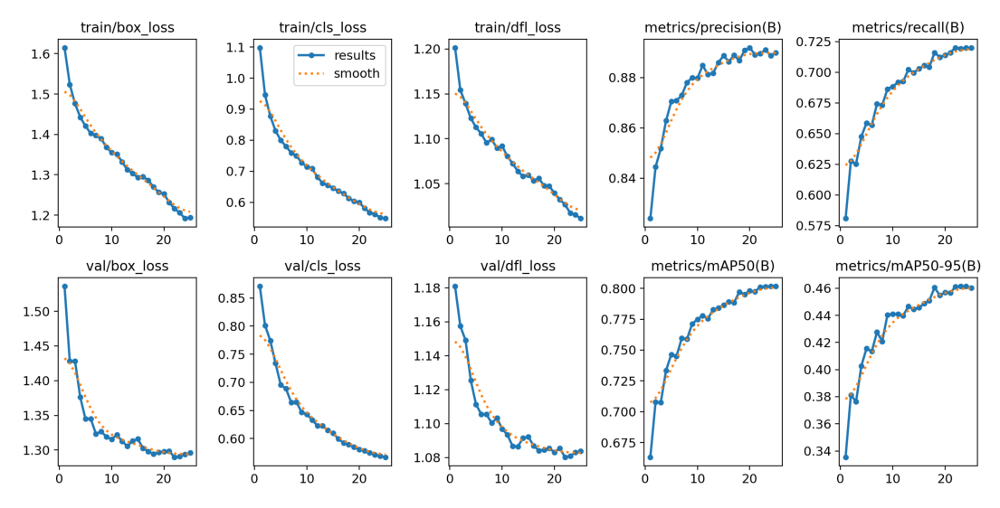

In [ ]:
plt.figure(figsize=(14, 8))

img = Image.open(os.path.join(name_project, "results.png"))
plt.imshow(img)
plt.axis("off");

It can be observed that there is slight overfitting, as the training losses in the last epochs are slightly lower than the validation losses. If training were to continue for more epochs, the overfitting would start to increase. Additionally, the validation and training losses in the last epochs begin to converge, with the validation losses even starting to increase. Furthermore, the validation metrics in the last epochs begin to plateau without any significant improvement. Therefore, considering all these factors, the best hyperparameters have been chosen to make the model converge in just 25 epochs, achieving the best results.

### **Validation Dataset**

Although the model automatically generates validation metrics and graphs upon completing the training, this evaluation can also be performed using ``model.eval()``. By adding the argument ``verbose=True``, more detailed metrics for each class will be printed to the screen.

In [ ]:
path_eval_val = os.path.join(name_project, "eval_val")

results = model.val(
    data=os.path.join(path_dataset, "data.yaml"),
    name=path_eval_val,
    verbose=True
)

Ultralytics 8.3.34 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,030,803 parameters, 0 gradients, 67.6 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 25.4MB/s]
val: Scanning /content/datasets/WIDER-FACE/val/labels... 3226 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3226/3226 [00:01<00:00, 1772.16it/s]

val: New cache created: /content/datasets/WIDER-FACE/val/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 202/202 [02:51<00:00,  1.18it/s]


                   all       3226      39122       0.89       0.72      0.802      0.461
Speed: 0.6ms preprocess, 45.4ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /content/drive/MyDrive/Ultralytics/FaceDetection_YOLO11m_WIDER-FACE/eval_val


The model has achieved a **mAP50** of **0.802** and a **mAP50-95** of **0.461** on the validation dataset, indicating high performance. Additionally, precision exceeds recall, suggesting that the model tends to produce more false negatives than false positives. This indicates that the model struggles more with detecting all the faces present in the images than with avoiding the detection of nonexistent faces. This is most likely due to the presence of very small instances and/or extreme variations in facial attributes.

### **Confusion Matrix**

The calculation of the confusion matrix in object detection is more complex than in image classification, as it considers not only the confidence score but also the overlap area of each prediction. Additionally, it includes a class called `background` that does not belong to the dataset. The confusion matrix provides a detailed analysis of the results, showing counts of true positives, false positives, and false negatives for each class, from which the precision and recall of the model in the validation set are derived.


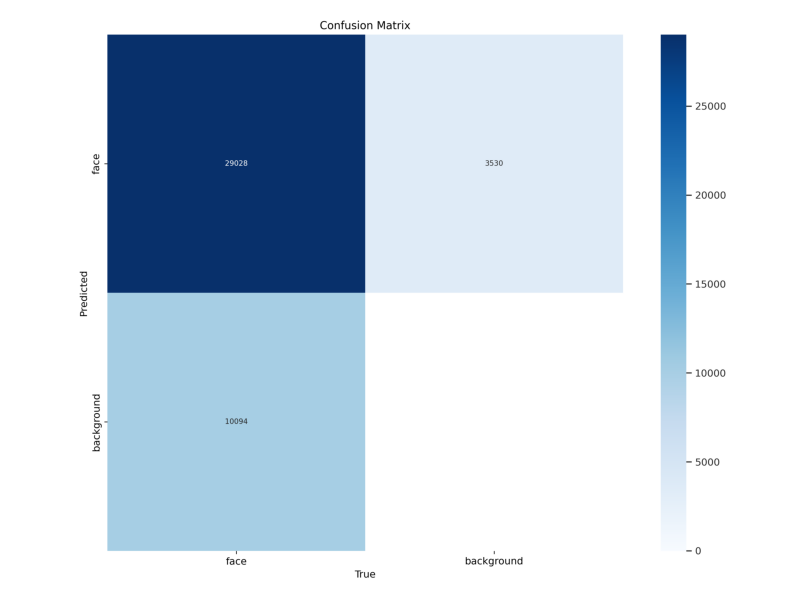

In [ ]:
plt.figure(figsize=(10, 10))

img = Image.open(os.path.join(name_project, "confusion_matrix.png"))
plt.imshow(img)
plt.axis("off");

The confusion matrix provides a clearer explanation of why precision is higher than recall. The model classified more instances as `background` when they were actually faces (false negatives) compared to cases where it detected faces that were actually `background` (false positives). This reinforces the earlier explanation.

## **Inference with the Trained Model**

Inference with a fine-tuned Ultralytics YOLO model is straightforward, as it accepts a wide range of image and video formats for predictions. Additionally, the results are presented graphically and can be obtained in real time. All accepted formats are detailed in the official [Ultralytics documentation](https://docs.ultralytics.com/modes/predict/#inference-sources).

In [ ]:
# Load the trained model
model = YOLO(os.path.join(name_project, "weights/best.pt"))

In [ ]:
# Function for image inference
def object_detection(images, n_rows=2, n_cols=1, show_labels=True, save=False, path_save=""):
  n_samples = int(n_rows*n_cols)
  images = np.random.choice(images, size=n_samples, replace=False)

  results = model.predict(
      source=images.tolist(),
      imgsz=1024,
      show_labels=show_labels,
      line_width=2,
      save=True,
      verbose=False
  )

  fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*8, n_rows*5))
  axes = axes.flatten() if n_samples > 1 else [axes]
  results = glob("/content/runs/detect/predict/*.jpg")

  clear_output(wait=False)
  for i, result in enumerate(results):
    result = Image.open(result)
    axes[i].imshow(result)
    axes[i].axis("off")

  plt.tight_layout()
  # Save images
  if save:
    plt.savefig(path_save)

  plt.show()
  shutil.rmtree("/content/runs/")

### **Validation Dataset**

In [ ]:
# Extract all the paths of the validation images
images_val = glob(os.path.join(path_dataset, "val/images/*.jpg"))

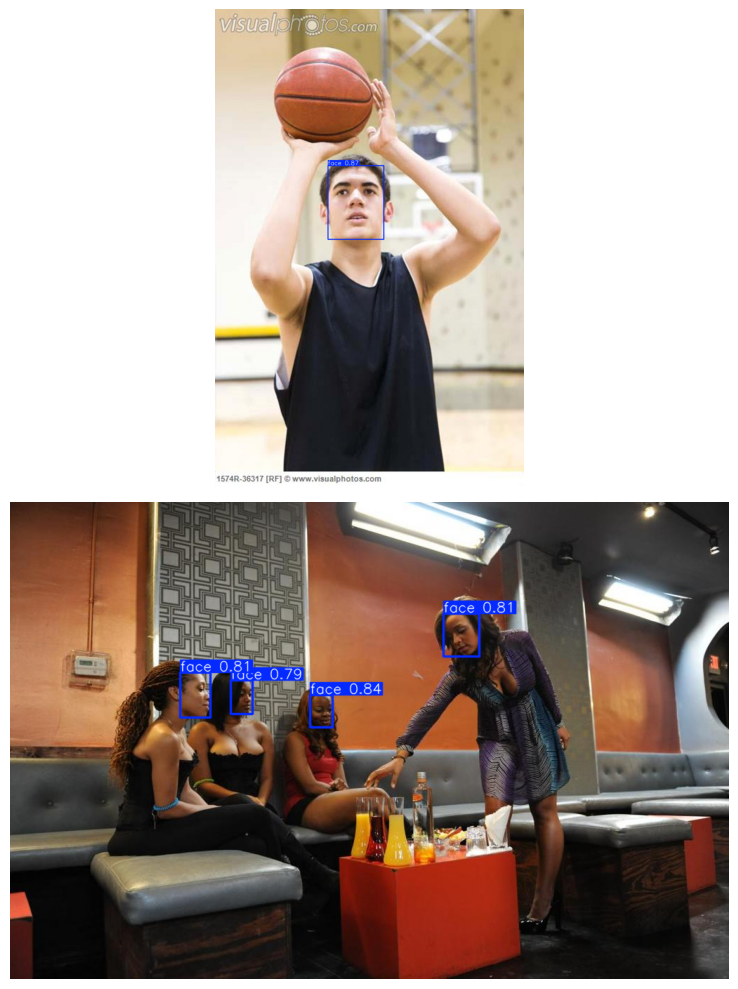

In [ ]:
object_detection(images_val)

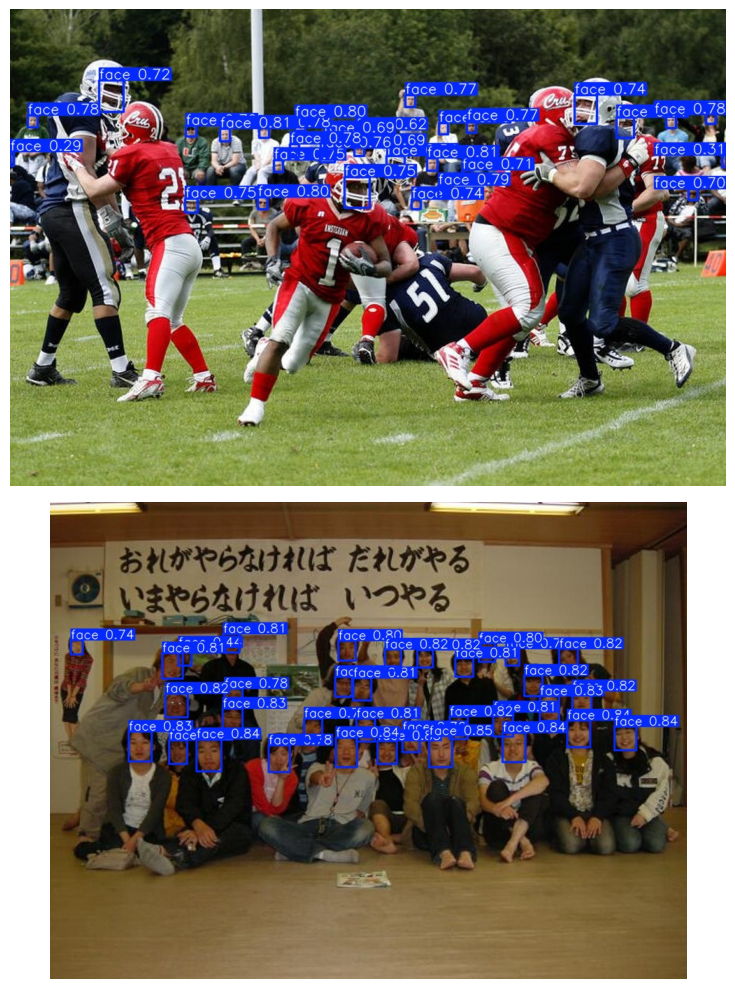

In [ ]:
object_detection(images_val, save=True, path_save="FaceDetection_YOLO11m_WIDER-FACE_1.png")

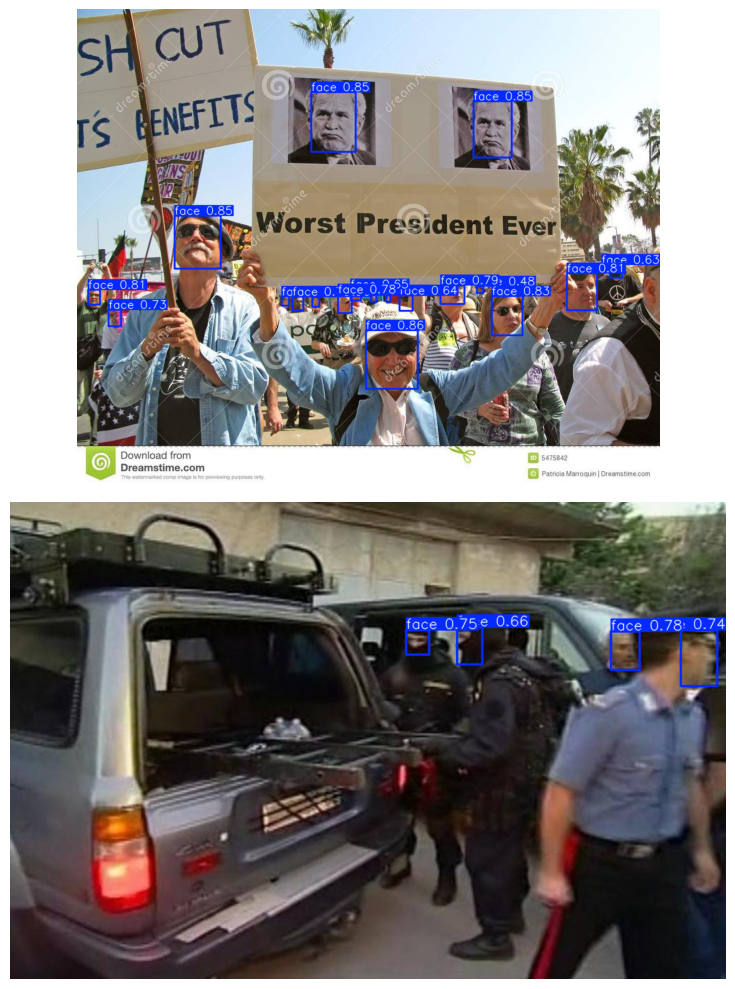

In [ ]:
object_detection(images_val)

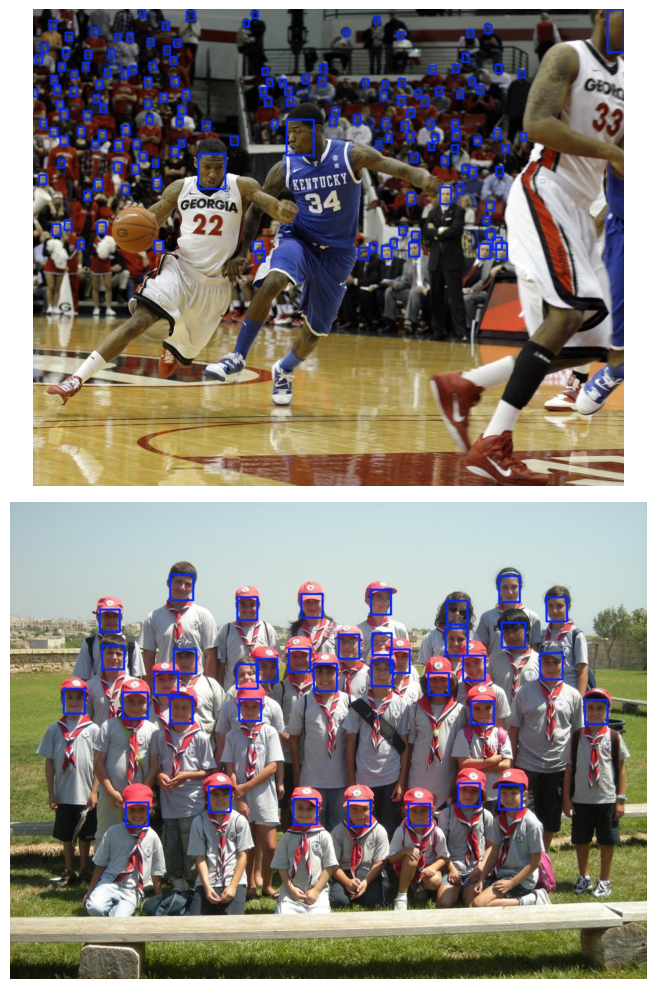

In [ ]:
object_detection(images_val, show_labels=False)

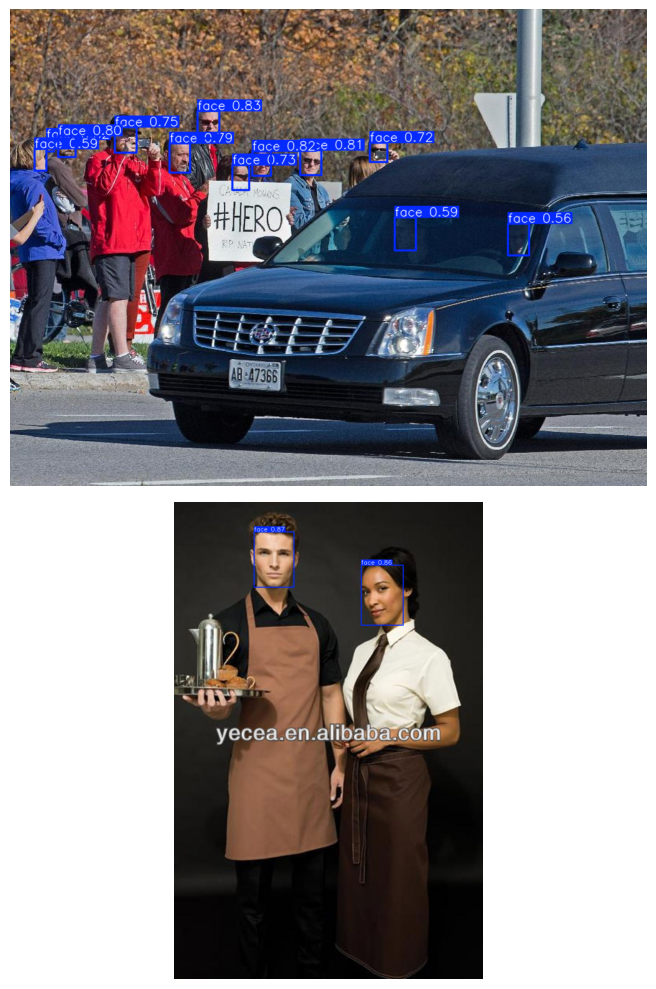

In [ ]:
object_detection(images_val)

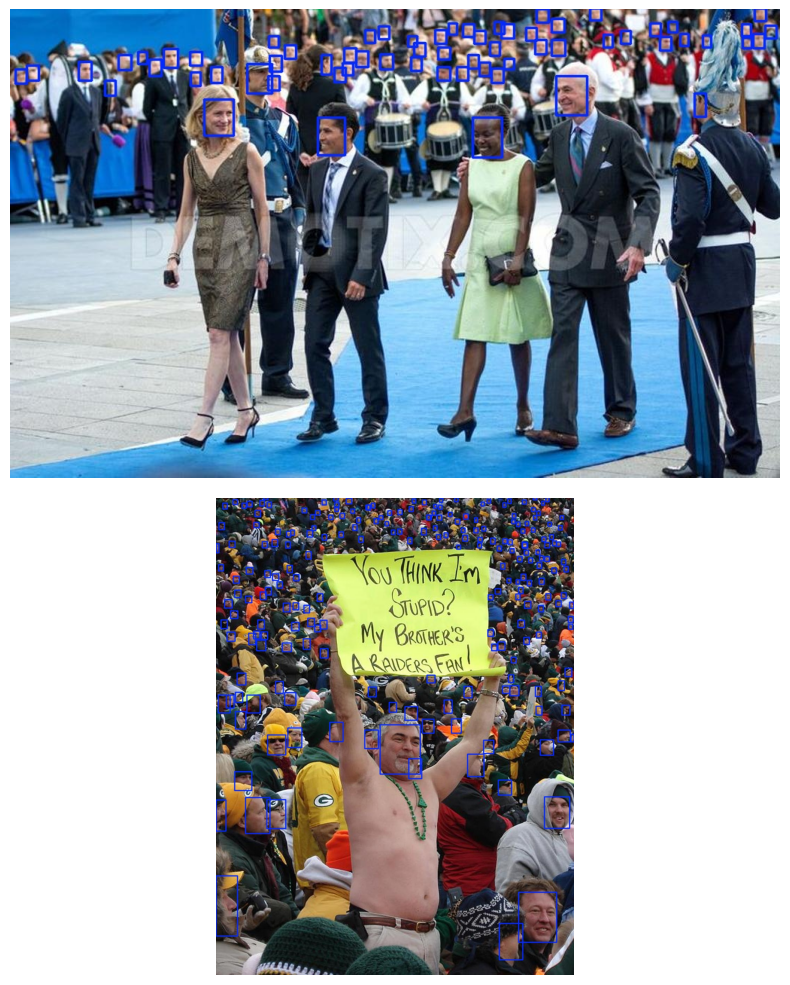

In [ ]:
object_detection(
    images_val,
    show_labels=False,
    save=True,
    path_save="FaceDetection_YOLO11m_WIDER-FACE_2.png"
)

### **Internet Images**

In [ ]:
url_images = [
    "https://i.pinimg.com/originals/63/57/67/63576721f6fc4049966788a248e8d6c3.jpg",
    "https://media.licdn.com/dms/image/v2/C4D12AQFV4qSUdCwF6w/article-cover_image-shrink_720_1280/article-cover_image-shrink_720_1280/0/1575856352461?e=2147483647&v=beta&t=cIwTcX9WcZYJiLBG7uk0vHlmnIQRYHQltkBvwePZRYc",
    "https://media.cnn.com/api/v1/images/stellar/prod/130223184327-01-spain-protests-0223.jpg?q=w_3000,h_1688,x_0,y_0,c_fill",
    "https://www.infobae.com/resizer/v2/TVQMQR75ENCKLPTMBRT4SSGNAI.jpg?auth=848094959c2fb78e72dc128afa6df82d7a2e55978e90cfc73346f2e0e6e84a91&smart=true&width=1200&height=630&quality=85",
    "https://scontent.flim6-4.fna.fbcdn.net/v/t1.6435-9/46479677_2224150847595359_529316193375354880_n.jpg?_nc_cat=105&ccb=1-7&_nc_sid=127cfc&_nc_ohc=mpygCNZ9ybcQ7kNvgFxQiBZ&_nc_oc=AdgA5ZkY8zHinfUtgheULQLggiUYphgJjJqGQiT8D1owfS1DqLxl-CJRiwkd5WMzKgM&_nc_zt=23&_nc_ht=scontent.flim6-4.fna&_nc_gid=AJb4vLI2cLtFS25ZEw2lGQK&oh=00_AYAxcqhbKMDnKB-bPc-go9CF33Sn6e2puRzW5Zxyamtung&oe=6765C295",
    "https://estaticos-cdn.prensaiberica.es/clip/2cd494ac-6817-432d-ab70-72cba36a206c_16-9-discover-aspect-ratio_default_0.jpg"
]

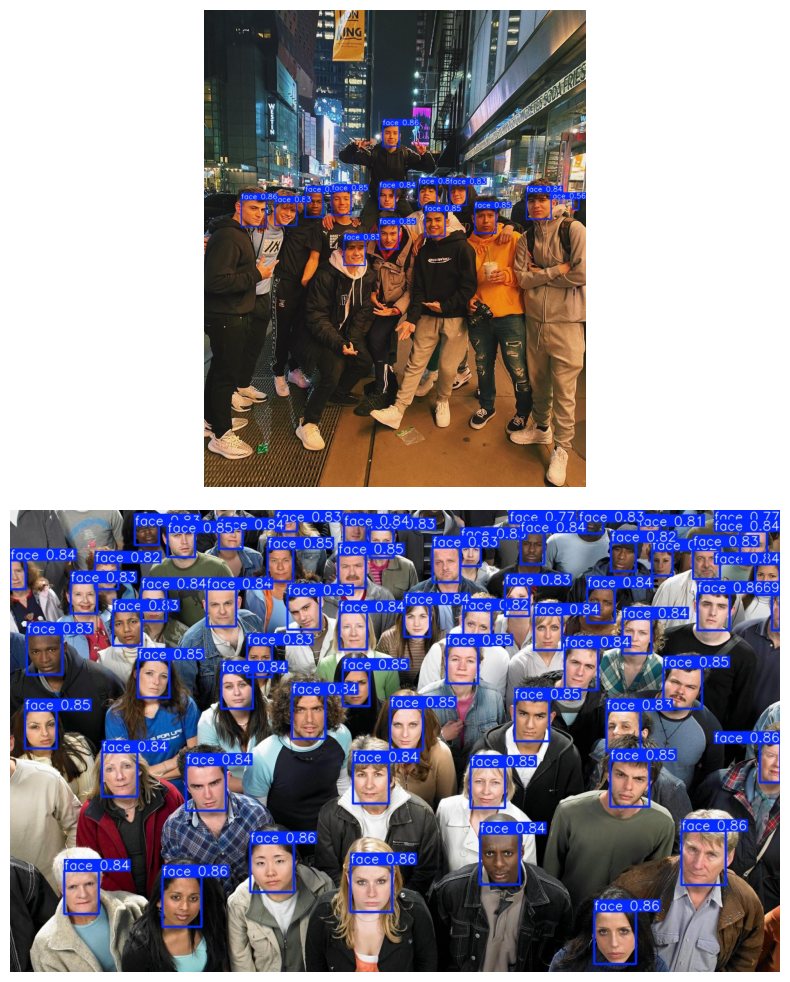

In [ ]:
object_detection(url_images[:2])

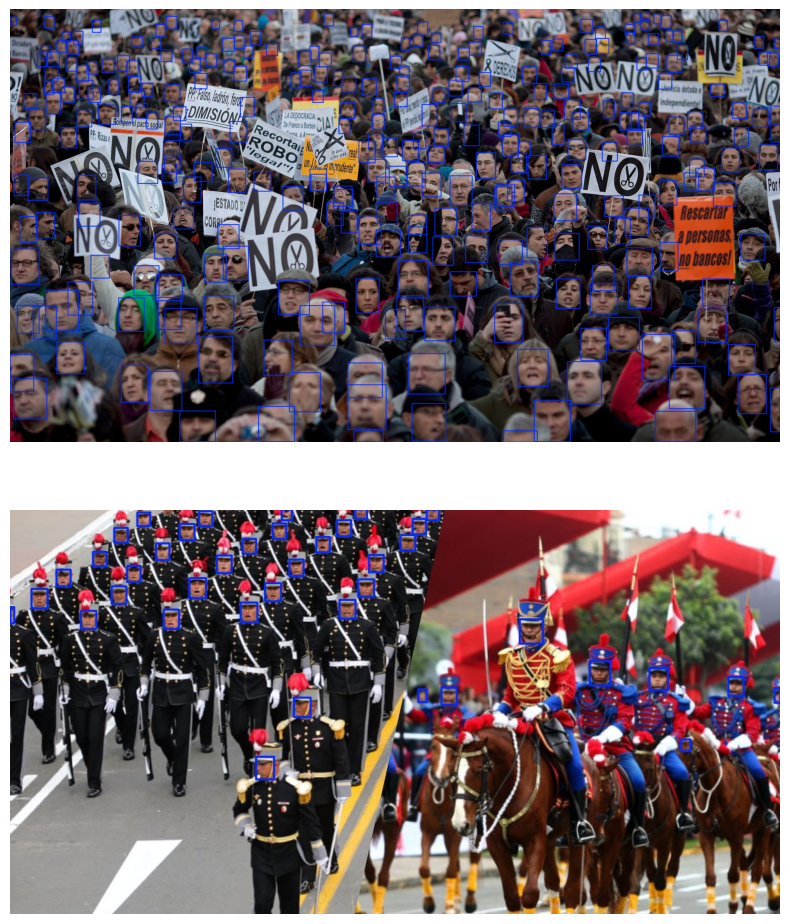

In [ ]:
object_detection(
    url_images[2:4],
    show_labels=False,
    save=True,
    path_save="FaceDetection_YOLO11m_WIDER-FACE_3.png"
)

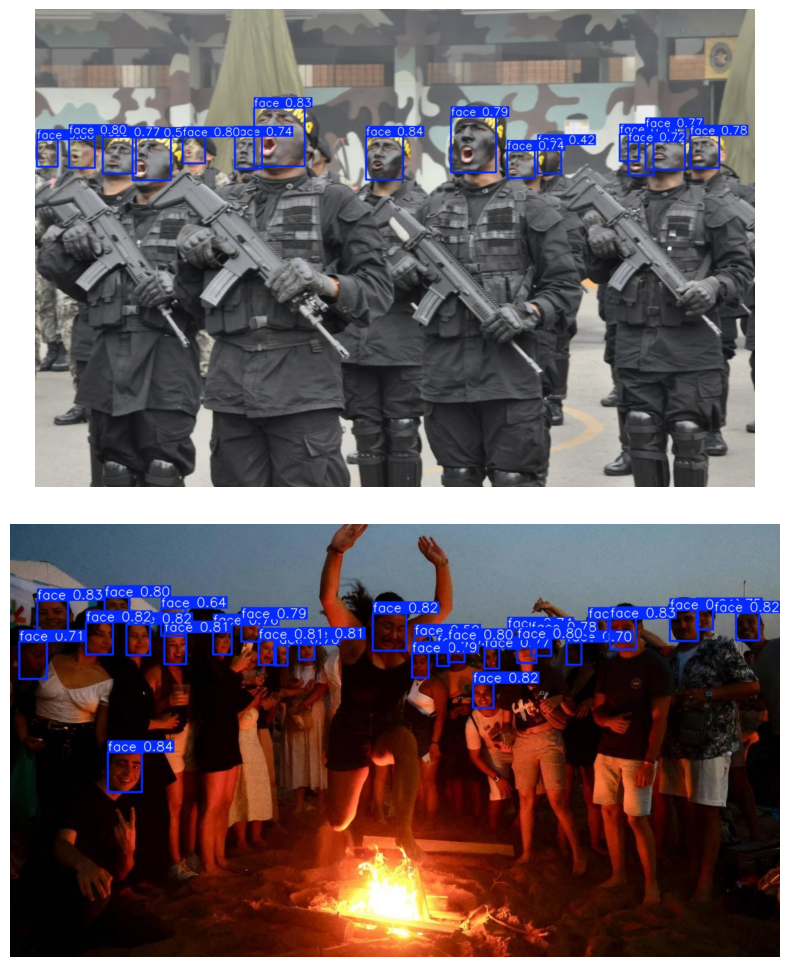

In [ ]:
object_detection(url_images[4:], save=True, path_save="FaceDetection_YOLO11m_WIDER-FACE_4.png")

### **Video Inference**

The videos used for inference are downloaded from the [Vecteezy](https://es.vecteezy.com/) website.

In [ ]:
url_videos = [
    "/content/drive/MyDrive/Videos/face_1.mp4",
    "/content/drive/MyDrive/Videos/face_2.mp4"
]

In [ ]:
# Function for video inference
def object_detection_video(url_video, path_video):
  results = model.predict(
      source=url_video,
      imgsz=1024,
      line_width=2,
      stream=False,
      stream_buffer=False,
      vid_stride=1,
      save=True,
      save_frames=False,
      verbose=False
  )

  # Convert the video from AVI to MP4
  name = url_video.split("/")[-1].split(".")[0]
  path_results = os.path.join("/content/runs/detect/predict", f"{name}.avi")
  !ffmpeg -i $path_results $path_video -loglevel quiet -y
  shutil.rmtree("/content/runs/")

  clear_output(wait=False)
  display(Video(path_video, embed=True, width=800, height=500))

In [ ]:
object_detection_video(url_videos[0], "FaceDetection_YOLO11m_WIDER-FACE_1.mp4")

In [ ]:
object_detection_video(url_videos[1], "FaceDetection_YOLO11m_WIDER-FACE_2.mp4")

## **Conclusion**

The fine-tuned **YOLO11m** model achieved a **mAP50** of **0.802** and a **mAP50-95** of **0.461** on the **WIDER FACE** validation dataset. These results indicate excellent performance in face detection, especially considering the dataset's complexity, which includes very small-scale faces and faces with extreme variations. Even better results could potentially be achieved by expanding the training dataset with more images and instances per image, as well as leveraging more advanced Ultralytics models, such as **YOLO11l** and **YOLO11x**. However, this would require significant manual effort to gather additional images and better computational resources than Colab's free GPU to accelerate training or sustain it for more than 9.5 hours. Nonetheless, based on the current metrics and performance on image and video inferences, the fine-tuned model demonstrates excellent performance for this task.

